## SSD

### **¿Qué es SSD?**

[Enlace al paper original](https://www.cs.utoronto.ca/~bonner/courses/2020s/csc2547/papers/discriminative/object-detection/ssd,-liu,-eccv-2016.pdf)

**SSD (Single Shot MultiBox Detector)** esun modelo avanzado de detección de objetos diseñado para proporcionar una combinación de precisión y velocidad.

SSD pertenece a la familia de **modelos de detección de una sola etapa**, lo que implica que realiza tanto la predición de las bounding boxes como la clasificación de los objetos en una única pasada a través de la red. Esto lo diferencia de modelos de dos etapas, como Faster R-CNN, que generan propuestas iniciales y posteriormente refinan las predicciones en una segunda fase.

### **Principios de funcionamiento**

1. **Detección en una sola etapa**

  SSD fusiona la detección de bounding boxes y la clasificación en una única operación.

  Para ello, utiliza directamente los mapas de características extraídos del backbone de la red y realiza predicciones en múltiples niveles, optimizando tanto la rapidez como la simplicidad arquitectónica.

  <font color = grey> Nota: Backbone → Parte central de una Neural Network encargada de extraer representaciones jerárquicas y significativas de los datos de entrada, generalmente mediante capas convolucionales. </font>

2. **Predicciones multiescala:**

  Una de las características distintivas de SSD es el uso de múltiples mapas de características a diferentes escalas para detectar objetos de diferentes tamaños. Esto se logra extendiendo el backbone con capas convolucionales adicionales que disminuyen progresivamente la resolución espacial.
  Las capas con resoluciones más altas detectan objetos pequeños, mientras que las capas de menor resolución manejan objetos más grandes.

3. **Cajas delimitadoras**

  En cada ubicación del mapa de característicaas, SSD genera un conjunto de cajas predeterminadas con diferentes tamaños, relaciones de aspecto y posiciones iniciales. Estas cajas actúan como hipótesis iniciales para las detecciones.

  Durante el entrenamiento, las cajas predeterminadas se ajustan para coincidir con los objetos reales en las imagenes mediante la predicción de desplazamientos y escalas.

4. **Regresión y clasificación conjunta**

  Para cada caja predeterminada, SSD predice:

    - Las coordenadas ajustadas de la bounding box
    - Las puntuaciones de confianza para cada clase de objeto

  Estas predicciones se realizan mediante capas convolucionales que aplican regresión para las coordenadas y clasificacioón para las clases.

5. **Mecanismo de pérdida**

  SSD utiliza una función de pérdida compuesta que combina:

    - *Smooth L1 loss* para los desplazamientos de las cajas predichas
    - *Categorical cross-entropy* para la clasificación

  Además, se implementa una estrategia de hard negative mining para equilibrar el sesgo inherente de las clases, debido a la gran cantidad de cajas predeterminadas negativas (sin objetos).
  
Imagen comparativa entre YOLO y SSD del paper original [Enlace al paper original](https://www.cs.utoronto.ca/~bonner/courses/2020s/csc2547/papers/discriminative/object-detection/ssd,-liu,-eccv-2016.pdf)

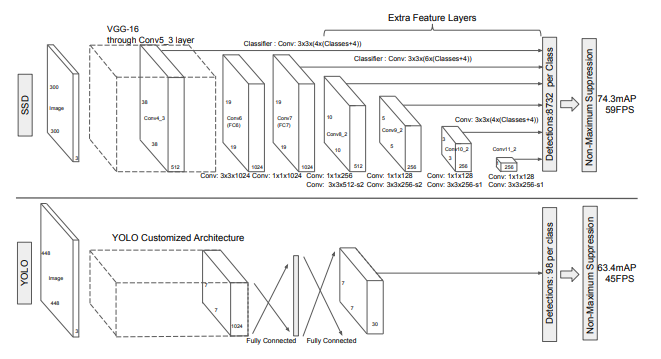

In [ ]:
import os
import torch
import xml.etree.ElementTree as ET
from PIL import Image
import matplotlib.pyplot as plt
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms
from torchvision.models.detection import ssd300_vgg16, SSD300_VGG16_Weights
from torchvision.models.detection.ssdlite import SSDLiteClassificationHead
import torch.optim as optim
from functools import partial
from torchvision.models.detection import _utils as det_utils
import torch.nn as nn
import matplotlib.patches as patches
from torchvision.transforms.functional import to_pil_image
import shutil
import os
from PIL import Image, ImageDraw
import xmltodict
from glob import glob
import cv2
from torchvision.transforms import functional as F
import random
import math
from sklearn.metrics import precision_score, recall_score, accuracy_score, f1_score
import pandas as pd
import numpy as np
from torch.cuda.amp import GradScaler, autocast

### Prepararción de los datos
Definimos los paths de nuestros datos

In [ ]:
train_data = PATH_XMLS_ORGINAL + 'train/'
valid_data = PATH_XMLS_ORGINAL + 'valid/'
test_data = PATH_XMLS_ORGINAL + 'test/'

Visualizamos una imagen y una etiqueta para ver si hemos cargado adecuadamente los datos

Image path ==> /content/drive/My Drive/Colab Notebooks/VC_PROYECTO/XMLS_ORIGINAL/train//airport_1_jpg.rf.970c8b6b8ad9e5b03d04de8971aea24e.jpg
Label path ==> /content/drive/My Drive/Colab Notebooks/VC_PROYECTO/XMLS_ORIGINAL/train//airport_1_jpg.rf.970c8b6b8ad9e5b03d04de8971aea24e.xml


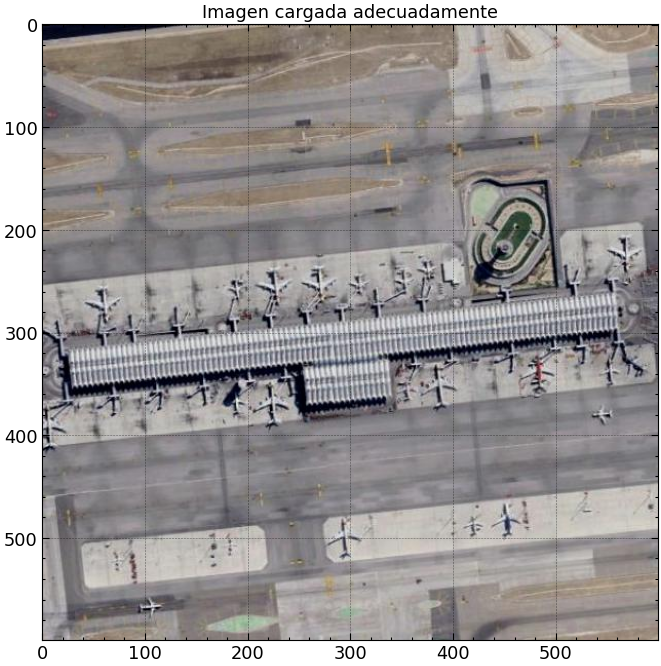

cat: /content/drive/My: No such file or directory
cat: Drive/Colab: No such file or directory
cat: Notebooks/VC_PROYECTO/XMLS_ORIGINAL/train//airport_1_jpg.rf.970c8b6b8ad9e5b03d04de8971aea24e.xml: No such file or directory


In [ ]:
image_path = train_data + '/airport_1_jpg.rf.970c8b6b8ad9e5b03d04de8971aea24e.jpg'
label_path = train_data + '/airport_1_jpg.rf.970c8b6b8ad9e5b03d04de8971aea24e.xml'

print("Image path ==> " + image_path + "\nLabel path ==> " + label_path)

# Mostrar imagen
img = Image.open(image_path)
plt.figure(figsize=(10,10))
plt.imshow(img)
plt.title("Imagen cargada adecuadamente")
plt.show()

# Mostrar etiquetas
!cat {label_path}

Definimos una función para visualizar las imagenes con sus respectivas bounding boxes

In [ ]:
def visualizar_anotaciones(image_dir, num_imagenes):
    """
    Selecciona aleatoriamente un número de imágenes del directorio dado,
    dibuja las anotaciones (bounding boxes) sobre las imágenes y las muestra.

    Args:
    - image_dir (str): Ruta al directorio que contiene imágenes y etiquetas XML.
    - num_imagenes (int): Número de imágenes a seleccionar aleatoriamente.
    """
    # Obtener todas las imágenes del directorio
    image_files = [f for f in os.listdir(image_dir) if f.endswith('.jpg')]

    # Seleccionar aleatoriamente imágenes
    seleccionadas = random.sample(image_files, min(num_imagenes, len(image_files)))

    for image_file in seleccionadas:
        # Ruta de la imagen
        image_path = os.path.join(image_dir, image_file)
        img = Image.open(image_path)

        # Ruta del archivo XML correspondiente
        annotation_file = os.path.join(image_dir, os.path.splitext(image_file)[0] + '.xml')

        # Verificar si la anotación existe antes de intentar procesarla
        if not os.path.exists(annotation_file):
            print(f"Anotación no encontrada para {image_file}. Saltando...")
            continue

        # Parsear el archivo XML
        tree = ET.parse(annotation_file)
        root = tree.getroot()

        # Dibujar las bounding boxes
        draw = ImageDraw.Draw(img)
        for obj in root.findall('object'):
            label = obj.find('name').text
            bndbox = obj.find('bndbox')
            xmin = int(bndbox.find('xmin').text)
            ymin = int(bndbox.find('ymin').text)
            xmax = int(bndbox.find('xmax').text)
            ymax = int(bndbox.find('ymax').text)

            # Dibujar la caja y añadir el label
            draw.rectangle([xmin, ymin, xmax, ymax], outline='red', width=3)
            draw.text((xmin, ymin), label, fill='red')

        # Mostrar la imagen con bounding boxes
        plt.imshow(img)
        plt.axis('off')
        plt.title(f"Imagen con anotaciones: {image_file}")
        plt.show()

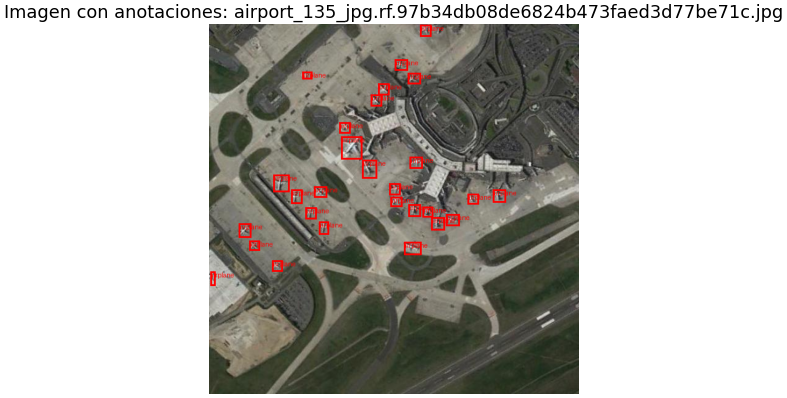

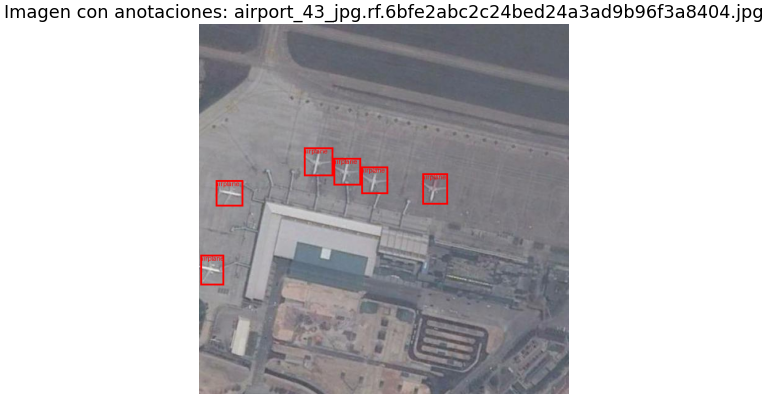

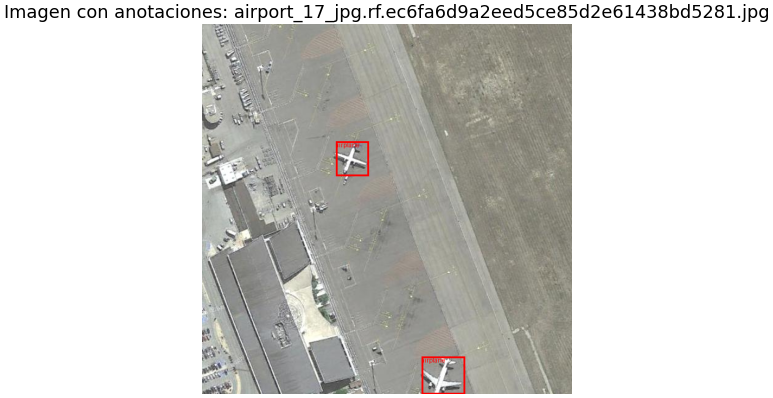

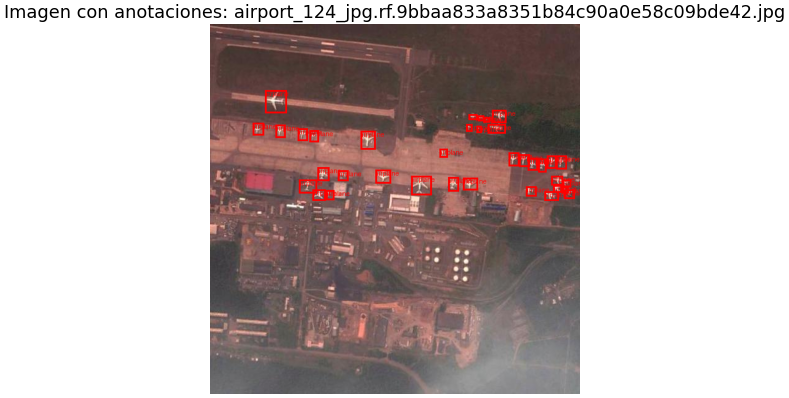

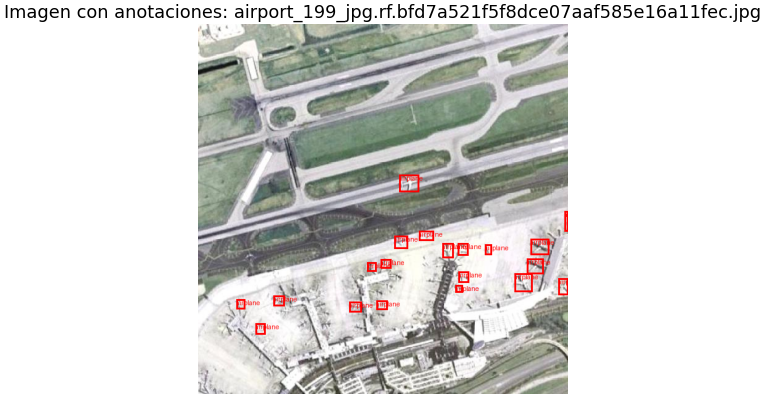

In [ ]:
visualizar_anotaciones(train_data, 5)

Comprobamos que todas las etiquetas tengan aviones y vemos algunas métricas

Configuramos el dispositivo en el que se ejecutará el modelo de PyTorch (CPU o GPU).

Si hay una GPU disponible, la usamos para acelerar considerablemente el entrenamiento y la inferencia del modelo, ya que las GPUs están optimizadas para operaciones matriciales y tensores.

Si no hay GPUs, se ejecutará en CPU, aunque sea más lento.

In [ ]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print("Using device:", device)

Using device: cuda


#### DataSet personalizado



Definimos una clase personalizada para gestionar el dataset de imágenes y anotaciones (en formato XML), para que sea compatible con PyTorch y nuestro modelo.

En este caso estamos utilizando el formato **Pascal VOC** debido a su soporte nativo con la implementación de SSD en PyTorch que estamos utilizando

Por ello el objetivo de este apartado concretamente es:
- Leer imágenes y sus anotaciones correspondientes
- Aplicar transformaciones opcionales y escalar las cajas delimitadoras
- Preparar los datos en tensores PyTorch (`img`, `targets`) listos para el entrenamiento

In [ ]:
class CustomSSDDataset(torch.utils.data.Dataset):
    def __init__(self, root_dir, transforms=None):
        self.root_dir = root_dir
        self.transforms = transforms
        self.image_files = sorted([f for f in os.listdir(root_dir) if f.endswith('.jpg')])

        # Verifica si faltan anotaciones XML
        for img_file in self.image_files:
            xml_file = os.path.splitext(img_file)[0] + '.xml'
            if not os.path.exists(os.path.join(root_dir, xml_file)):
                print(f"Advertencia: Falta archivo XML para {img_file}")

    def __len__(self):
        return len(self.image_files)

    def __getitem__(self, idx):
        # Carga la imagen
        img_filename = self.image_files[idx]
        img_path = os.path.join(self.root_dir, img_filename)
        xml_filename = os.path.splitext(img_filename)[0] + '.xml'
        xml_path = os.path.join(self.root_dir, xml_filename)
        img = Image.open(img_path).convert("RGB")  # Asegura que esté en RGB
        original_width, original_height = img.size

        # Procesa las anotaciones
        boxes, labels = self.parse_annotation(xml_path)

        # Aplica transformaciones y escala las cajas
        if self.transforms:
            img = self.transforms(img)
            scale_x = 600 / original_width
            scale_y = 600 / original_height
            boxes = [[xmin * scale_x, ymin * scale_y, xmax * scale_x, ymax * scale_y] for xmin, ymin, xmax, ymax in boxes]

        # Convierte las cajas y etiquetas a tensores
        if len(boxes) == 0:
            boxes_tensor = torch.zeros((0, 4), dtype=torch.float32)
            labels_tensor = torch.zeros((0,), dtype=torch.int64)
        else:
            boxes_tensor = torch.tensor(boxes, dtype=torch.float32)
            labels_tensor = torch.tensor(labels, dtype=torch.int64)

        target = {"boxes": boxes_tensor, "labels": labels_tensor}
        return img, target

    def parse_annotation(self, xml_path):
        """
        Lee y procesa un archivo XML en formato Pascal VOC.
        """
        if not os.path.exists(xml_path):
            print(f"Advertencia: No se encontró el archivo XML: {xml_path}")
            return [], []

        boxes, labels = [], []
        tree = ET.parse(xml_path)
        root = tree.getroot()

        for obj in root.findall("object"):
            label_name = obj.find("name").text
            label = 1 if label_name == 'airplane' else 0  # Ajusta según las clases
            bndbox = obj.find("bndbox")
            xmin = float(bndbox.find("xmin").text)
            ymin = float(bndbox.find("ymin").text)
            xmax = float(bndbox.find("xmax").text)
            ymax = float(bndbox.find("ymax").text)
            boxes.append([xmin, ymin, xmax, ymax])
            labels.append(label)

        return boxes, labels


Visualizamos para comprobar que estamos cargando los datasets adecuadamente

In [ ]:
def visualize_dataset(dataset, num_examples=5):
    """
    Visualiza ejemplos del dataset con imágenes y cajas delimitadoras.

    Args:
        dataset: Instancia del dataset (CustomSSDDataset).
        num_examples: Número de ejemplos a visualizar.
    """
    for idx in range(num_examples):
        # Obtiene la imagen y las anotaciones
        img, target = dataset[idx]

        # Convierte el tensor de imagen a formato PIL si es necesario
        if isinstance(img, torch.Tensor):
            img = to_pil_image(img.clamp(0, 1))

        # Crea la figura para mostrar la imagen
        plt.figure(figsize=(8, 8))
        plt.imshow(img)

        # Extrae las cajas y etiquetas
        boxes = target["boxes"].numpy()
        labels = target["labels"].numpy()

        # Dibuja las cajas delimitadoras
        ax = plt.gca()
        for box, label in zip(boxes, labels):
            xmin, ymin, xmax, ymax = box
            rect = patches.Rectangle(
                (xmin, ymin), xmax - xmin, ymax - ymin,
                linewidth=2, edgecolor='red', facecolor='none'
            )
            ax.add_patch(rect)
            ax.text(xmin, ymin - 5, f"{label}", color="yellow", fontsize=10,
                    bbox=dict(facecolor="red", alpha=0.5))

        # Configuración final de la figura
        plt.axis("off")
        plt.title(f"Ejemplo {idx + 1}")
        plt.show()

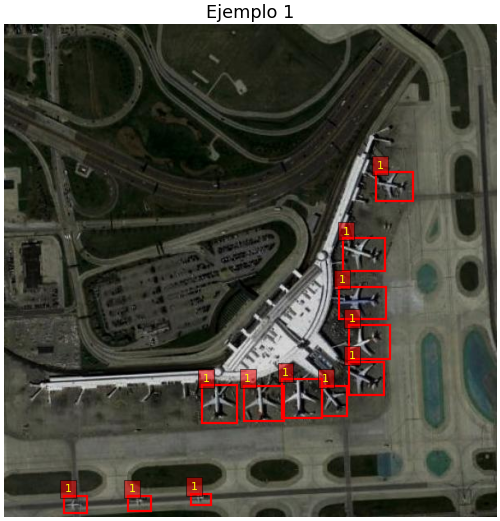

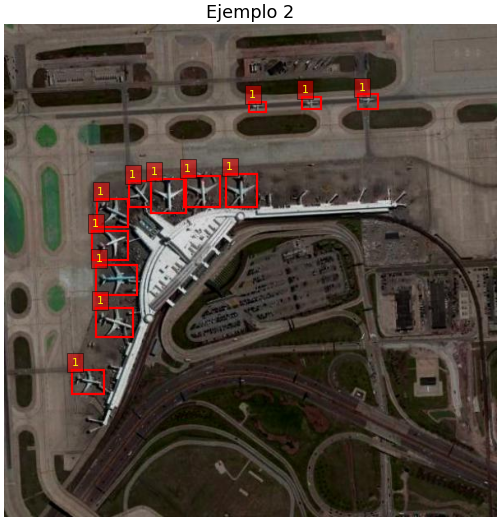

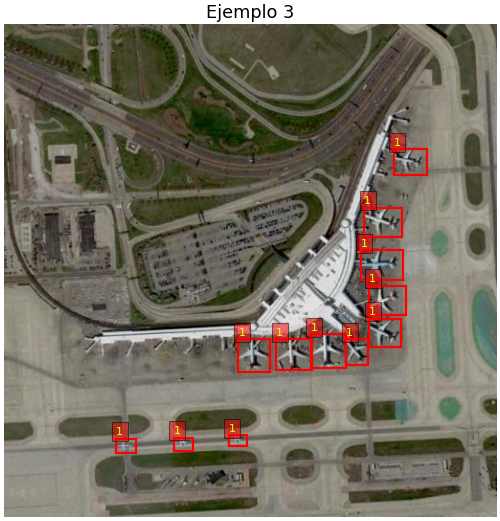

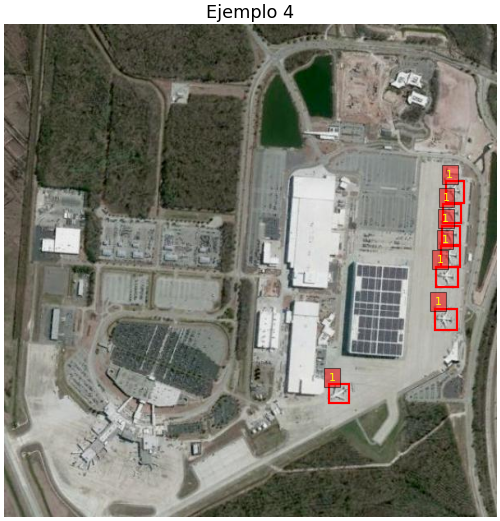

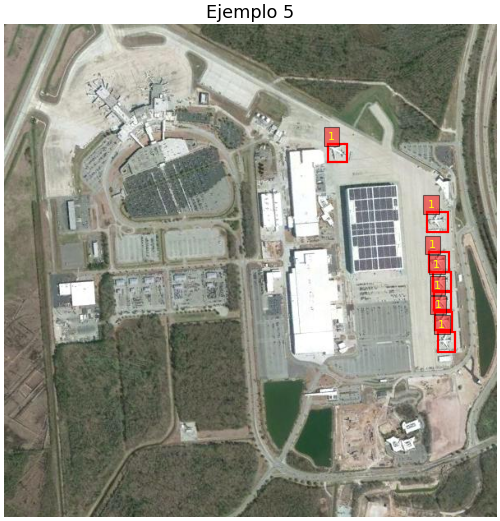

In [ ]:
from torchvision import transforms

data_transforms = transforms.Compose([
    transforms.Resize((600, 600)),
    transforms.ToTensor(),
])

dataset = CustomSSDDataset(train_data, transforms=data_transforms)
visualize_dataset(dataset, num_examples=5)

Pasamos a configurar las transformaciones de datos, los datasets y los DataLoaders, que son componentes clave para manejar y preparar los datos de manera eficiente durante el entrenamiento y validación.

1. **`collate_fn`**:  
   Combina los datos individuales (imagen y anotaciones) de un batch en una estructura compatible con el modelo.  
   Tiene como entrada un batch (lista de tuplas (`img`, `target`)), donde la `img` es la imagen transformada y el `target` es un diccionario con `boxes` y `labels`.  
   Como salida, devuelve una tupla de listas, donde la primera lista contiene las imágenes y la segunda los targets.

   **Ejemplo**:

   ```python
   batch = [(img1, target1), (img2, target2), (img3, target3)]
   collate_fn(batch)  # Devuelve ([img1, img2, img3], [target1, target2, target3])
   ```

2. **`normalize`** y **`data_transforms`**:
    Redimensionamos todas las imagenes a $600 \times 600$ píxeles para que el modelo las procese uniformemente (estamos utilizando en todos los modelos el mismo tamaño para hacer una comparativa más justa).

    Transformamos la imagen PIL (valores [0-255]) a un tensor PyTorch (valores [0-1]), para que PyTorch procese las imagenes.

    Además normalizamos a los valores estandar de ImageNet ya que al usar un modelo preentrenado (SSD con pesos de COCO) espera valores normalizados, por lo que de no hacerlo el rendimiento empeoraría.

#### Dataloaders

In [ ]:
def collate_fn(batch):
    return tuple(zip(*batch))

In [ ]:
# normalize = transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])

data_transforms = transforms.Compose([
    transforms.Resize((600, 600)),
    transforms.ToTensor(),
])

train_dataset = CustomSSDDataset(train_data, data_transforms)
val_dataset = CustomSSDDataset(valid_data, data_transforms)
test_dataset = CustomSSDDataset(test_data, data_transforms)


train_loader = DataLoader(train_dataset, batch_size=8, shuffle=True, collate_fn=collate_fn)
val_loader = DataLoader(val_dataset, batch_size=8, shuffle=False, collate_fn=collate_fn)
test_loader = DataLoader(test_dataset, batch_size=8, shuffle=False, collate_fn=collate_fn)

### Carga del modelo

In [ ]:
def crear_modelo_ssd(device):
    # Cargamos el modelo preentrenado en el dataset COCO
    weights = SSD300_VGG16_Weights.COCO_V1
    model = ssd300_vgg16(weights=weights)

    # Ajustamos el numero de clases
    num_classes = 2
    in_channels = det_utils.retrieve_out_channels(model.backbone, (600, 600))
    num_anchors = model.anchor_generator.num_anchors_per_location()
    norm_layer = partial(nn.BatchNorm2d, eps=0.001, momentum=0.03) # Batch norm (obliga la nueva classification Head)

    model.head.classification_head = SSDLiteClassificationHead(
        in_channels,
        num_anchors,
        num_classes,
        norm_layer
    )

    for param in model.parameters():
        param.requires_grad = True

    return model.to(device)

In [ ]:
model = crear_modelo_ssd(device)
model

Downloading: "https://download.pytorch.org/models/ssd300_vgg16_coco-b556d3b4.pth" to /root/.cache/torch/hub/checkpoints/ssd300_vgg16_coco-b556d3b4.pth
100%|██████████| 136M/136M [00:01<00:00, 90.2MB/s]


SSD(
  (backbone): SSDFeatureExtractorVGG(
    (features): Sequential(
      (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (1): ReLU(inplace=True)
      (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (3): ReLU(inplace=True)
      (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
      (5): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (6): ReLU(inplace=True)
      (7): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (8): ReLU(inplace=True)
      (9): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
      (10): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (11): ReLU(inplace=True)
      (12): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (13): ReLU(inplace=True)
      (14): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (15): ReLU(inplace=

#### Inferencia sin entrenamiento

In [ ]:
def infer_images(model, folder_path, device, num_images=1, score_threshold=0.3):
    model.eval()
    image_files = sorted([f for f in os.listdir(folder_path) if f.endswith('.jpg') or f.endswith('.png')])
    selected_images = image_files[:num_images]

    for img_file in selected_images:
        image_path = os.path.join(folder_path, img_file)
        image = Image.open(image_path).convert("RGB")
        original_width, original_height = image.size
        image_tensor = infer_transform(image).unsqueeze(0).to(device)

        model.eval()
        with torch.no_grad():
            predictions = model(image_tensor)

        boxes = predictions[0]["boxes"].cpu().numpy()
        labels = predictions[0]["labels"].cpu().numpy()
        scores = predictions[0]["scores"].cpu().numpy()

        scaled_boxes = []
        for box in boxes:
            xmin, ymin, xmax, ymax = box
            xmin *= original_width / 600
            ymin *= original_height / 600
            xmax *= original_width / 600
            ymax *= original_height / 600
            scaled_boxes.append([xmin, ymin, xmax, ymax])

        plt.figure(figsize=(8, 8))
        plt.imshow(image)
        ax = plt.gca()

        for box, label, score in zip(scaled_boxes, labels, scores):
            if score >= score_threshold:
                xmin, ymin, xmax, ymax = box
                rect = plt.Rectangle((xmin, ymin), xmax - xmin, ymax - ymin, fill=False, color="red", linewidth=2)
                ax.add_patch(rect)
                text = f"airplane: {score:.2f}"
                ax.text(xmin, ymin, text, bbox=dict(facecolor="yellow", alpha=0.5))

        plt.axis("off")
        plt.title(f"Predicciones para {img_file}")
        plt.show()

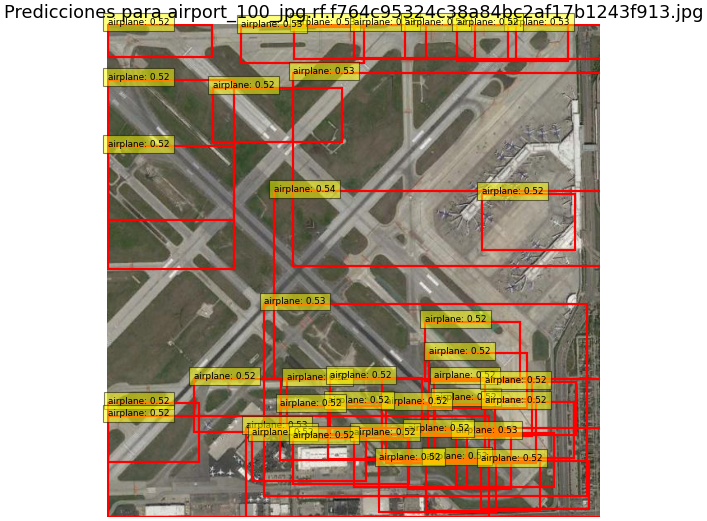

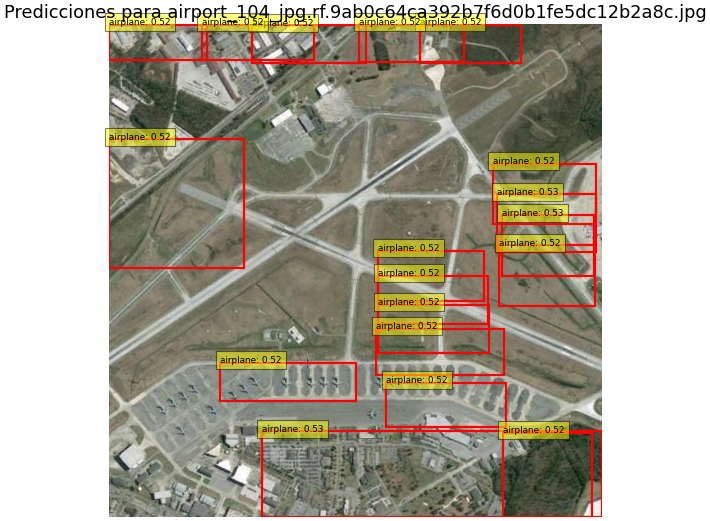

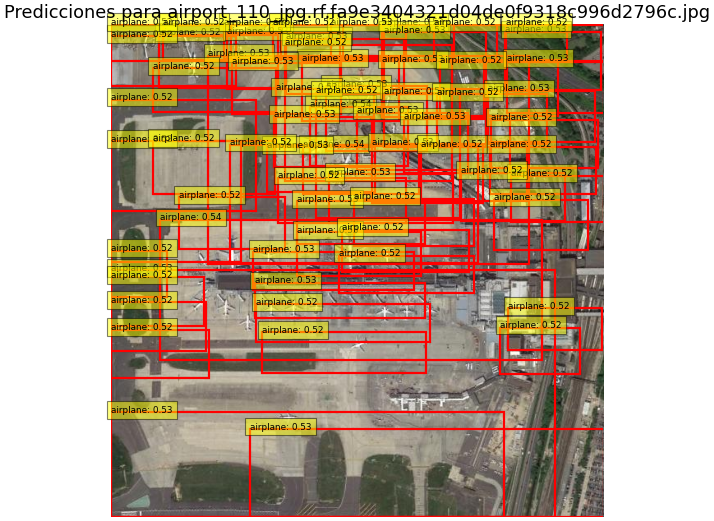

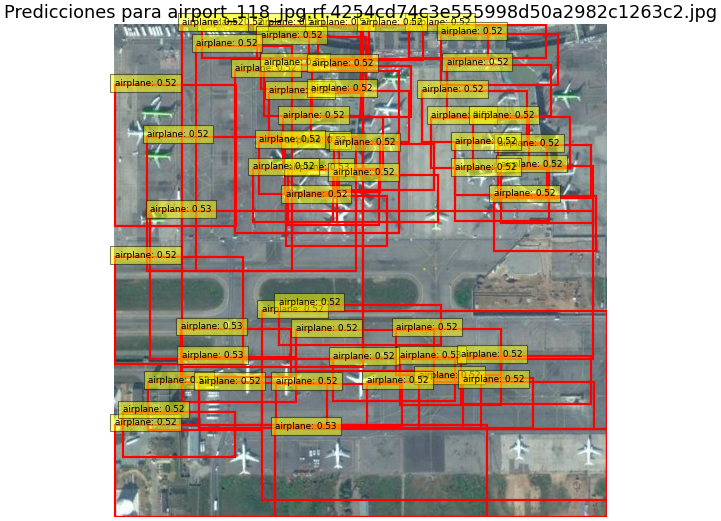

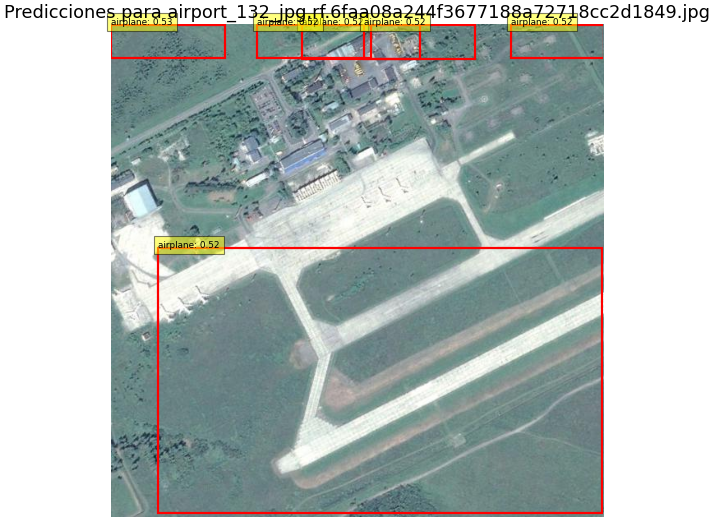

...

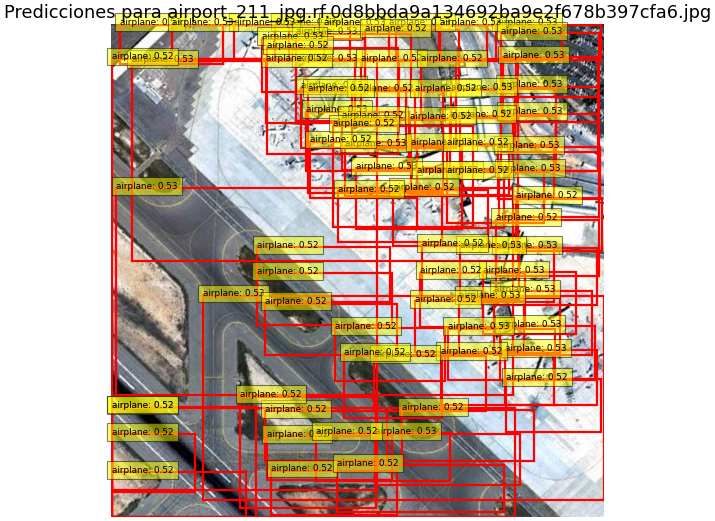

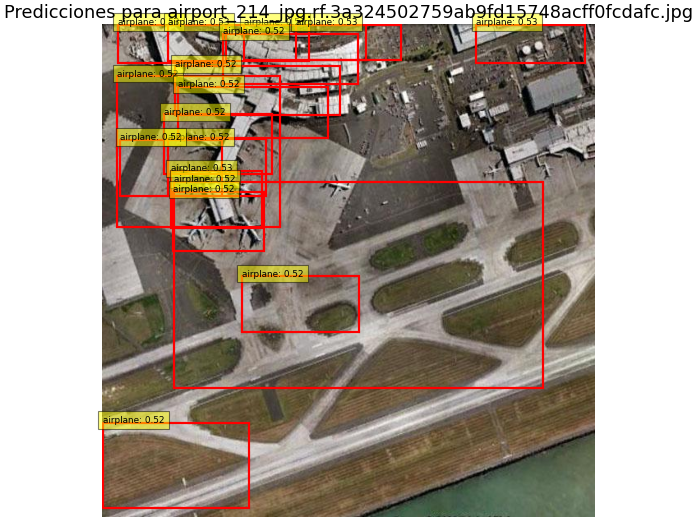

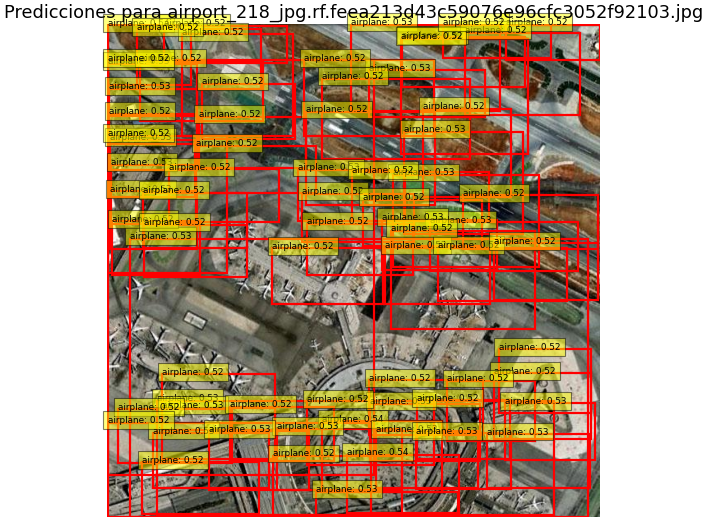

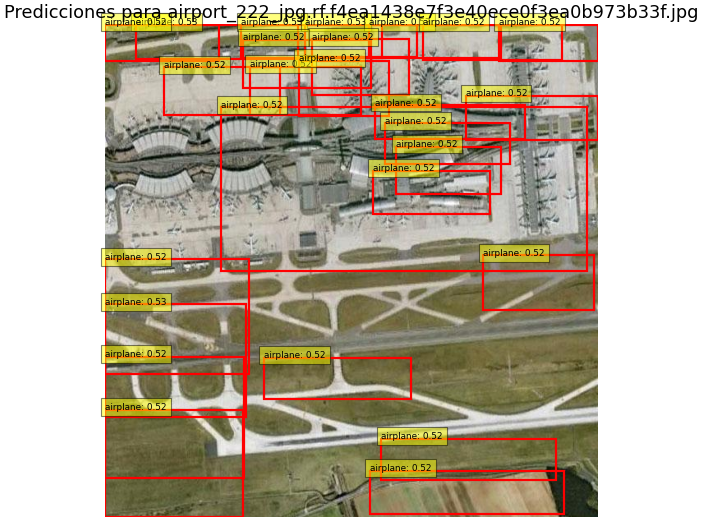

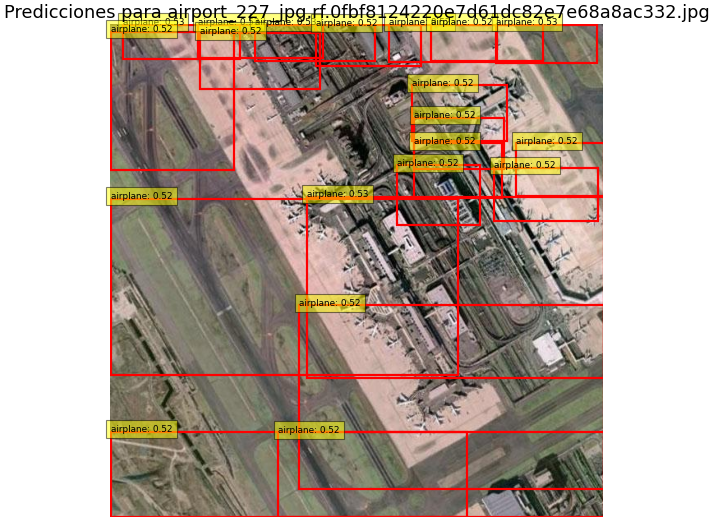

In [ ]:
infer_transform = transforms.Compose([
    transforms.Resize((600, 600)),
    transforms.ToTensor(),
])

test_folder_path = test_data
infer_images(model, test_folder_path, device, num_images=15, score_threshold=0.52)

Como se pueden observar, los resultados son realmente malos sin el entrenamiento previo

### Entrenamiento Conjunto Original

In [ ]:
def calc_iou_tensor(box1, box2):
    """Calculation of IoU based on two box tensors."""
    N = box1.size(0)
    M = box2.size(0)

    be1 = box1.unsqueeze(1).expand(-1, M, -1)
    be2 = box2.unsqueeze(0).expand(N, -1, -1)

    lt = torch.max(be1[:, :, :2], be2[:, :, :2])  # Left-Top
    rb = torch.min(be1[:, :, 2:], be2[:, :, 2:])  # Right-Bottom

    delta = rb - lt
    delta[delta < 0] = 0
    intersection = delta[:, :, 0] * delta[:, :, 1]

    delta1 = be1[:, :, 2:] - be1[:, :, :2]
    area1 = delta1[:, :, 0] * delta1[:, :, 1]
    delta2 = be2[:, :, 2:] - be2[:, :, :2]
    area2 = delta2[:, :, 0] * delta2[:, :, 1]

    union = area1 + area2 - intersection
    return intersection / (union + 1e-6)

In [ ]:
def calculate_metrics_with_iou(predictions, targets, iou_threshold=0.5):
    """Calcula precisión, recall y accuracy basados en IoU para las predicciones."""
    tp, fp, fn = 0, 0, 0

    for pred, tgt in zip(predictions, targets):
        pred_boxes = pred["boxes"]
        gt_boxes = tgt["boxes"]

        # Caso: No hay predicciones ni etiquetas
        if pred_boxes.numel() == 0 and gt_boxes.numel() == 0:
            continue

        # Caso: No hay predicciones
        if pred_boxes.numel() == 0:
            fn += len(gt_boxes)
            continue

        # Caso: No hay etiquetas
        if gt_boxes.numel() == 0:
            fp += len(pred_boxes)
            continue

        # Calcula IoU
        iou_matrix = calc_iou_tensor(pred_boxes, gt_boxes)

        # Match de IoUs mayores al umbral
        iou_matches = (iou_matrix >= iou_threshold).sum(dim=1)

        tp += (iou_matches > 0).sum().item()  # Detecciones correctamente hechas
        fp += (iou_matches == 0).sum().item()  # Predicciones no emparejadas
        fn += (iou_matrix.max(dim=0).values < iou_threshold).sum().item()  # Etiquetas no detectadas

    precision = tp / (tp + fp + 1e-6)
    recall = tp / (tp + fn + 1e-6)
    accuracy = tp / (tp + fp + fn + 1e-6)
    return precision, recall, accuracy

/tmp/ipykernel_1512249/448712442.py:10: FutureWarning: `torch.cuda.amp.GradScaler(args...)` is deprecated. Please use `torch.amp.GradScaler('cuda', args...)` instead.
  scaler = GradScaler()  # Para AMP (Automatic Mixed Precision)
/tmp/ipykernel_1512249/448712442.py:71: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with autocast():


Epoch [1/25] - Train Loss: 5.0780, Precision: 0.0426, Recall: 0.6230, Accuracy: 0.0413, F1-Score: 0.0798
Epoch [2/25] - Train Loss: 3.4079, Precision: 0.0534, Recall: 0.7512, Accuracy: 0.0521, F1-Score: 0.0997
Epoch [3/25] - Train Loss: 3.0008, Precision: 0.0597, Recall: 0.8217, Accuracy: 0.0585, F1-Score: 0.1112
Epoch [4/25] - Train Loss: 2.6749, Precision: 0.0612, Recall: 0.8269, Accuracy: 0.0601, F1-Score: 0.1140
Epoch [5/25] - Train Loss: 2.4575, Precision: 0.0601, Recall: 0.8278, Accuracy: 0.0590, F1-Score: 0.1120
Epoch [6/25] - Train Loss: 2.2741, Precision: 0.0610, Recall: 0.8267, Accuracy: 0.0599, F1-Score: 0.1136
Epoch [7/25] - Train Loss: 2.0517, Precision: 0.0626, Recall: 0.8360, Accuracy: 0.0614, F1-Score: 0.1164
Epoch [8/25] - Train Loss: 1.8779, Precision: 0.0625, Recall: 0.8541, Accuracy: 0.0615, F1-Score: 0.1164
Epoch [9/25] - Train Loss: 1.7470, Precision: 0.0608, Recall: 0.8439, Accuracy: 0.0598, F1-Score: 0.1134
Epoch [10/25] - Train Loss: 1.5531, Precision: 0.0585, 

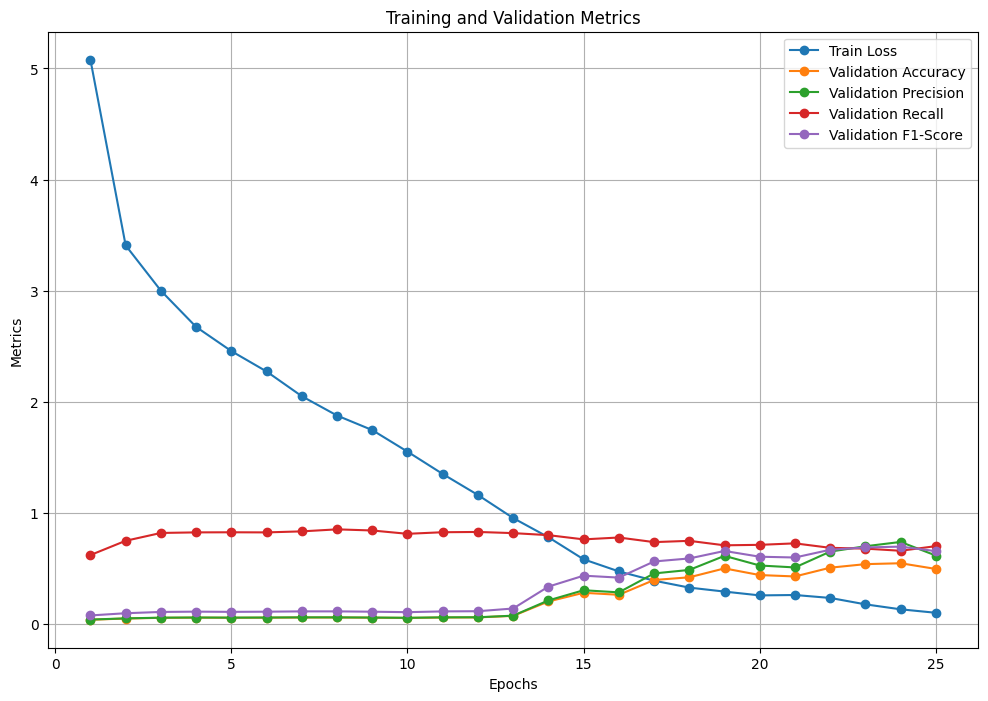

In [ ]:
# Configuración inicial
num_epochs = 25
optimizer = torch.optim.AdamW(model.parameters(), lr=0.0001, weight_decay=0.0005)
scheduler = torch.optim.lr_scheduler.OneCycleLR(
    optimizer,
    max_lr=0.01,
    steps_per_epoch=len(train_loader),
    epochs=num_epochs,
)
scaler = GradScaler()  # Para AMP (Automatic Mixed Precision)

# Para almacenar métricas
train_losses = []
val_accuracies = []
val_precisions = []
val_recalls = []
val_f1_metrics = []

model.train()


# Entrenamiento y Validación
for epoch in range(num_epochs):
    model.train()
    running_loss = 0.0

    # Entrenamiento
    for images, targets in train_loader:
        images = [img.to(device) for img in images]
        targets = [{k: v.to(device) for k, v in t.items()} for t in targets]

        optimizer.zero_grad()

        # Mixed Precision
        with autocast():
            loss_dict = model(images, targets)
            losses = sum(loss for loss in loss_dict.values())

        # Backpropagation y optimización
        scaler.scale(losses).backward()
        scaler.unscale_(optimizer)
        torch.nn.utils.clip_grad_norm_(model.parameters(), max_norm=5.0)
        scaler.step(optimizer)
        scaler.update()

        running_loss += losses.item()

    train_losses.append(running_loss / len(train_loader))

    # Validación
    model.eval()
    precision, recall, accuracy = 0, 0, 0
    with torch.no_grad():
        for images, targets in val_loader:
            images = [img.to(device) for img in images]
            targets = [{k: v.to(device) for k, v in t.items()} for t in targets]

            predictions = model(images)
            p, r, acc = calculate_metrics_with_iou(predictions, targets)
            precision += p
            recall += r
            accuracy += acc

    precision /= len(val_loader)
    recall /= len(val_loader)
    accuracy /= len(val_loader)
    f1_metric = 2 * (precision * recall) / (precision + recall + 1e-6)

    # Logging
    val_precisions.append(precision)
    val_recalls.append(recall)
    val_accuracies.append(accuracy)
    val_f1_metrics.append(f1_metric)

    print(f"Epoch [{epoch + 1}/{num_epochs}] - "
          f"Train Loss: {train_losses[-1]:.4f}, "
          f"Precision: {precision:.4f}, "
          f"Recall: {recall:.4f}, "
          f"Accuracy: {accuracy:.4f}, "
          f"F1-Score: {f1_metric:.4f}")

# Gráficas del proceso de entrenamiento y validación
epochs = range(1, num_epochs + 1)

plt.figure(figsize=(12, 8))
plt.plot(epochs, train_losses, label='Train Loss', marker='o')
plt.plot(epochs, val_accuracies, label='Validation Accuracy', marker='o')
plt.plot(epochs, val_precisions, label='Validation Precision', marker='o')
plt.plot(epochs, val_recalls, label='Validation Recall', marker='o')
plt.plot(epochs, val_f1_metrics, label='Validation F1-Score', marker='o')
plt.xlabel('Epochs')
plt.ylabel('Metrics')
plt.title('Training and Validation Metrics')
plt.legend()
plt.grid(True)
plt.show()

In [ ]:
model_save_path = PATH_PROYECTO + "modelo_ssd.pth"

torch.save(model.state_dict(), model_save_path)
print(f"Modelo guardado en {model_save_path}")

Modelo guardado en /mnt/homeGPU/azapata/ZapataComputerVision/modelo_ssd.pth


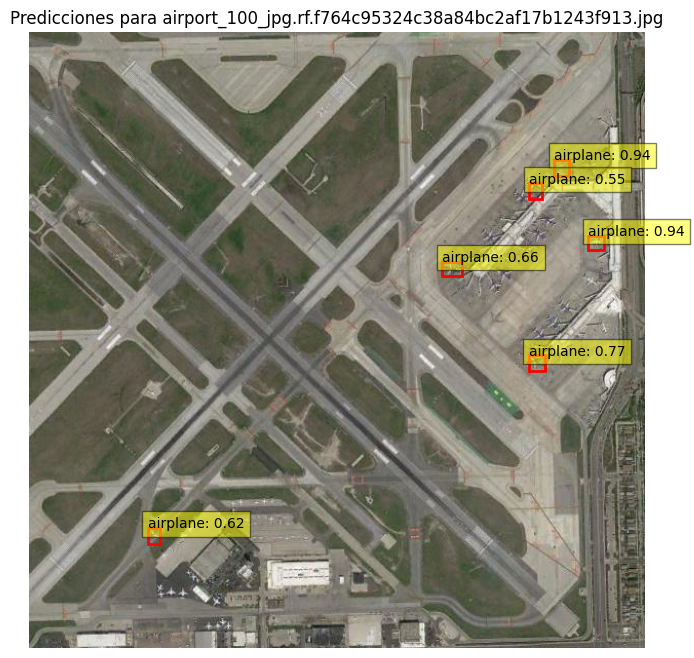

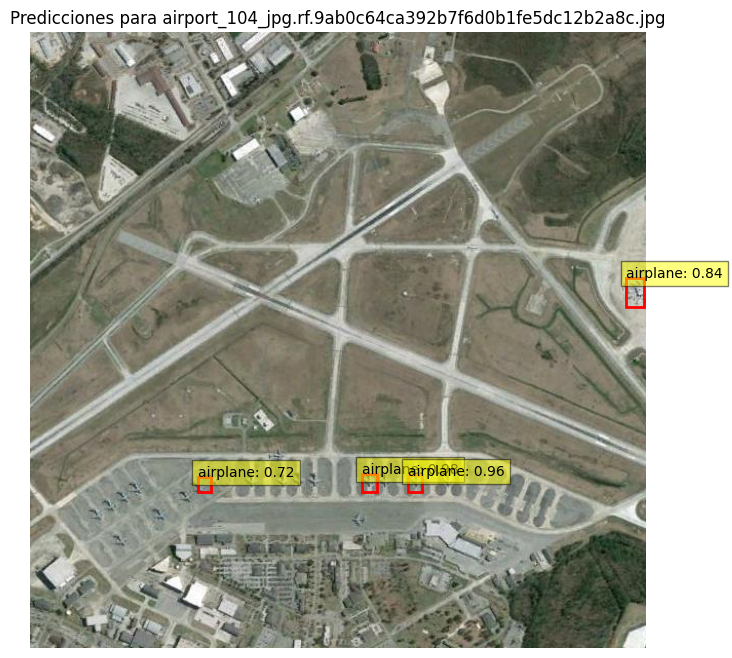

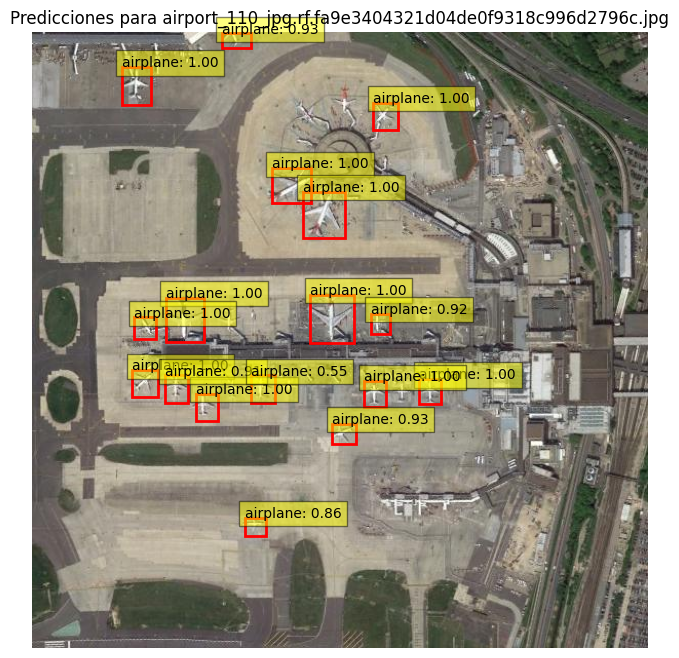

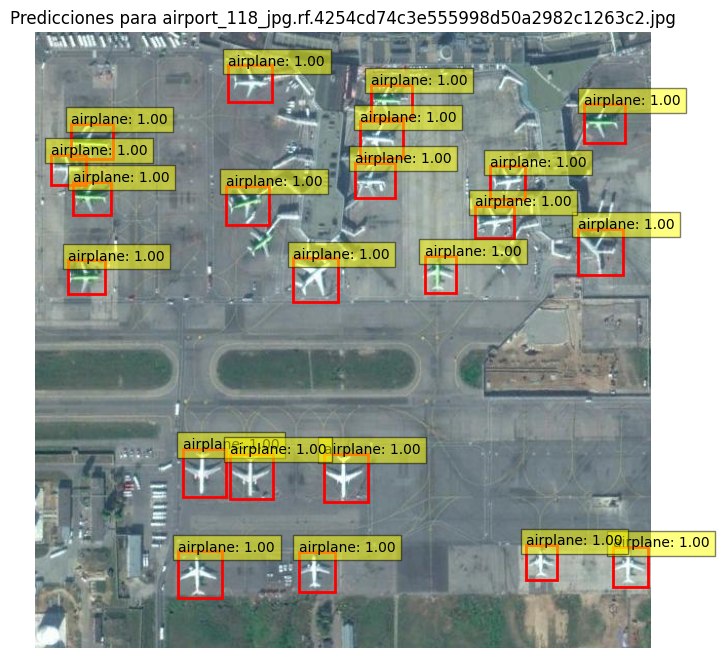

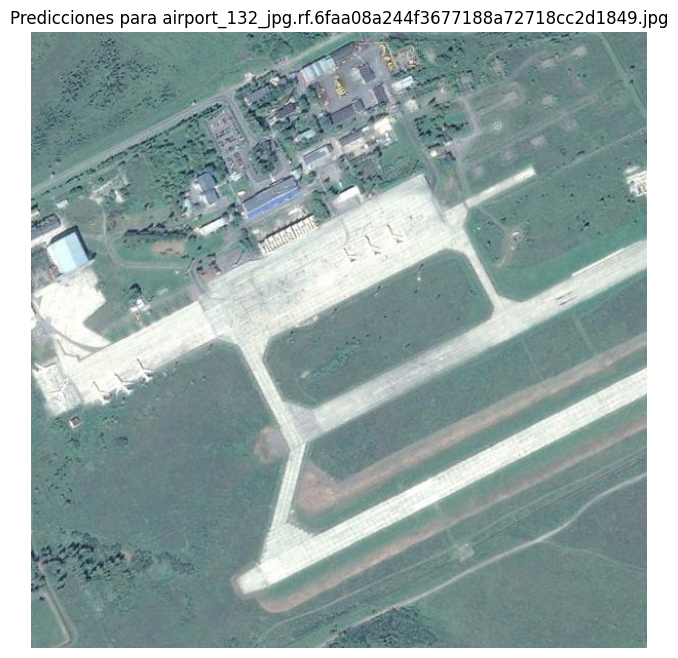

...

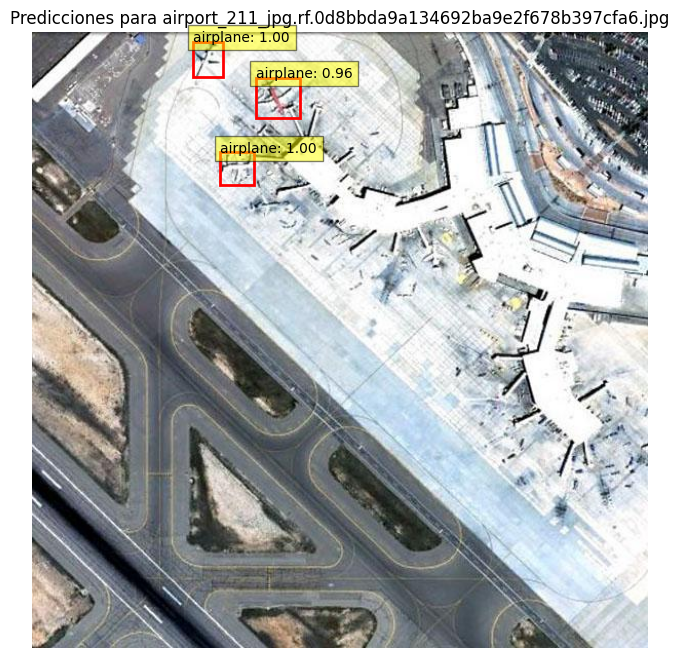

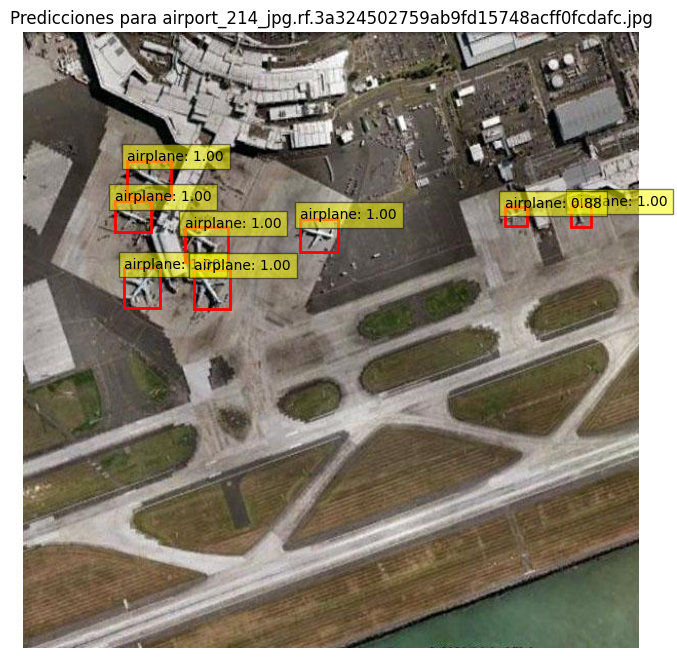

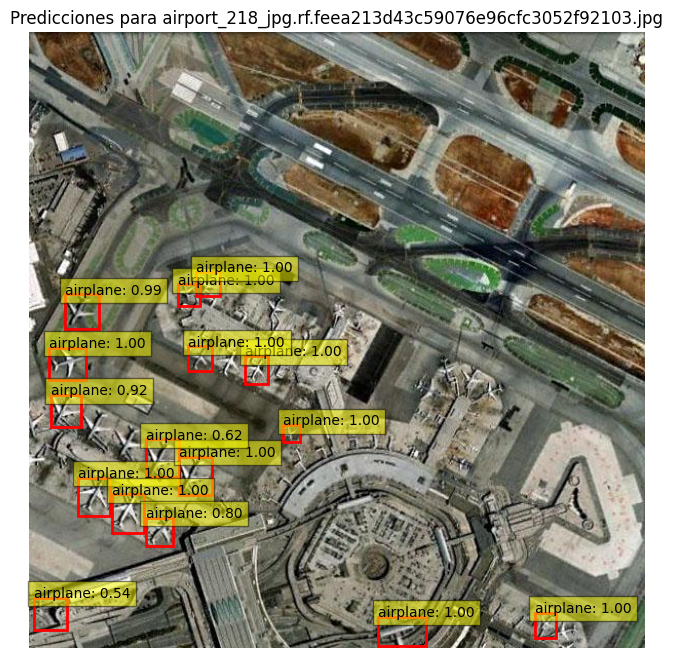

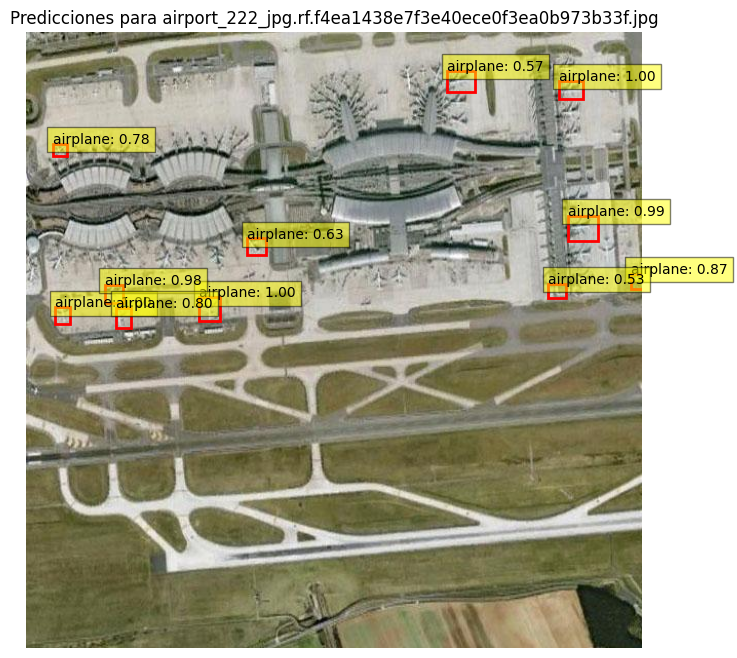

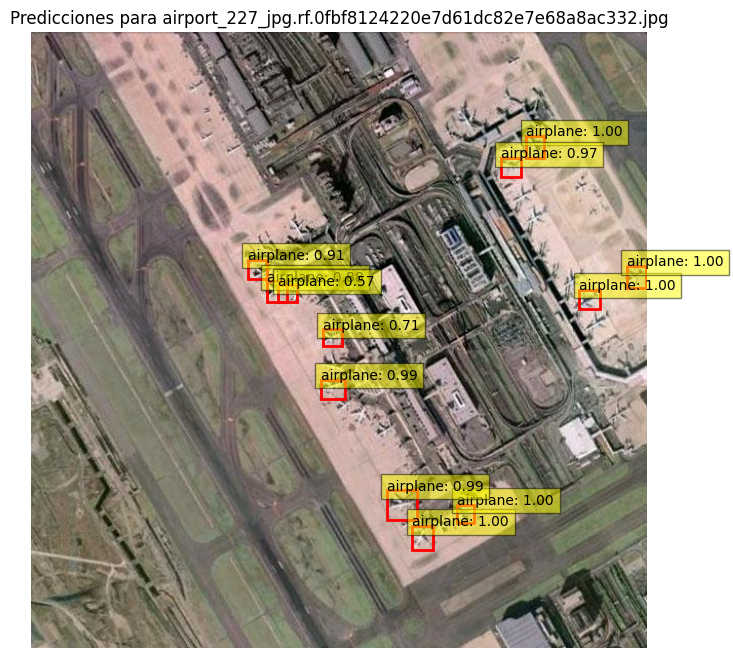

In [ ]:
valid_folder = valid_data
infer_images(model, valid_folder, device, num_images=15, score_threshold=0.5)

#### Métricas Conjunto de Datos Original

En este caso ya que SSD carece de alguna función de evaluación y la implementación de estas es relativamente compleja hemos decidido usar la misma forma de evaluación que se usa en faster rcnn y además tenemos así métricas comunes.

In [ ]:
def get_predictions_ssd(model, dataloader, device):
    model.eval()
    all_pred_boxes = []
    all_pred_labels = []
    all_pred_scores = []
    all_true_boxes = []
    all_true_labels = []

    with torch.no_grad():
        for images, targets in dataloader:
            images = [image.to(device) for image in images]
            targets = [{k: v.to(device) for k, v in t.items()} for t in targets]

            predictions = model(images)

            for prediction, target in zip(predictions, targets):
                all_pred_boxes.append(prediction['boxes'].cpu().numpy())
                all_pred_labels.append(prediction['labels'].cpu().numpy())
                all_pred_scores.append(prediction['scores'].cpu().numpy())
                all_true_boxes.append(target['boxes'].cpu().numpy())
                all_true_labels.append(target['labels'].cpu().numpy())

    return all_pred_boxes, all_pred_labels, all_pred_scores, all_true_boxes, all_true_labels

In [ ]:
from pycocotools.coco import COCO
from pycocotools.cocoeval import COCOeval

def evaluate_ssd(model, dataloader, path, device, confidence=0.5):
    model.eval()

    all_pred_boxes, all_pred_labels, all_pred_scores, all_true_boxes, all_true_labels = get_predictions_ssd(model, dataloader, device)

    coco_gt = COCO(path + '_annotations.coco.json')
    names = []
    ids = []

    for key, val in coco_gt.imgs.items():
        names.append(val['file_name'])
        ids.append(val['id'])

    names = np.array(names)
    ids = np.array(ids)
    idx = np.argsort(names)
    # names = names[idx]
    ids = ids[idx]

    coco_format_predictions = []
    for i, (pred_boxes, pred_labels, pred_scores) in enumerate(zip(all_pred_boxes, all_pred_labels, all_pred_scores)):
        for box, label, score in zip(pred_boxes, pred_labels, pred_scores):
            if score > confidence:
                width = box[2] - box[0]
                height = box[3] - box[1]
                coco_format_predictions.append({
                    'image_id': ids[i],
                    'category_id': label,
                    # 'bbox': box.tolist(),
                    'bbox': [box[0], box[1], width, height],
                    'score': score.item()
                })

    coco_dt = coco_gt.loadRes(coco_format_predictions)

    coco_eval = COCOeval(coco_gt, coco_dt, 'bbox')
    coco_eval.evaluate()
    coco_eval.accumulate()
    coco_eval.summarize()

    return coco_eval

In [ ]:
model_save_path = PATH_PROYECTO + "modelo_ssd.pth"

model = crear_modelo_ssd(device)
model.load_state_dict(torch.load(model_save_path))
model.eval();

<ipython-input-44-8775cfc5476c>:15: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load(PATH_PROYECTO + 'modelo_ssd.pth'))


In [ ]:
train_data = PATH_XMLS_ORGINAL + 'train/'
valid_data = PATH_XMLS_ORGINAL + 'valid/'
test_data = PATH_XMLS_ORGINAL + 'test/'

In [ ]:
data_transforms = transforms.Compose([
    transforms.Resize((600, 600)),
    transforms.ToTensor(),
])

train_dataset = CustomSSDDataset(train_data, data_transforms)
val_dataset = CustomSSDDataset(valid_data, data_transforms)
test_dataset = CustomSSDDataset(test_data, data_transforms)


train_loader = DataLoader(train_dataset, batch_size=8, shuffle=False, collate_fn=collate_fn)
val_loader = DataLoader(val_dataset, batch_size=8, shuffle=False, collate_fn=collate_fn)
test_loader = DataLoader(test_dataset, batch_size=8, shuffle=False, collate_fn=collate_fn)

In [ ]:
evaluate_ssd(model, train_loader, train_data, DEVICE, confidence=0.5);

loading annotations into memory...
Done (t=0.05s)
creating index...
index created!
Loading and preparing results...
DONE (t=0.02s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
DONE (t=6.04s).
Accumulating evaluation results...
DONE (t=0.17s).
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.596
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.947
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.676
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.532
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.819
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.841
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.052
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.377
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets

Podemos observar como se obtienen algunos resultados similares a los que se han calculado en el proceso de entrenamiento.

Vemos que sigue en cierto modo las mismas tendencias que Faster RCNN teniendo una precisión en torno al 60% lo siento mucho mayor cuando se permite un margen más laxo como un IoU de 0.5 y se va decrementando conforme este se hace más estricto.

Observamos como los objetos grandes son más sencillos de identificar y los pequeños los más complejos cosa que tiene sentido por el propio funcionamiento de estos modelos y la dificultad intrínseca de estos.

De forma análoga vemos que el recall tiene también valores altos lo que nos indica qué modelo se está comportando de manera correcta en ambas ocasiones.


Si lo comparamos con Faster RCNN vemos que se obtienen mejores resultados en absolutamente todas las métricas esto puede llegar a tener sentido puesto que SSD es un modelo más actual y por lo tanto puede llegar a ser más potente pese a ser de una única etapa.

In [ ]:
evaluate_ssd(model, val_loader, valid_data, DEVICE, confidence=0.5);

loading annotations into memory...
Done (t=0.01s)
creating index...
index created!
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
DONE (t=0.27s).
Accumulating evaluation results...
DONE (t=0.01s).
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.219
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.450
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.179
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.147
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.600
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.035
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.200
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDet

Sin embargo con los datos de validación vemos que esta tendencia ha cambiado y el modelo no ha sido capaz de generalizar obteniendo unos resultados mucho más inferiores al obtenidos en el conjunto de entrenamiento descendiendo del 61% de precisión en el resultado más real al 21%.

Esta tónica se repite en todas las diferentes métricas, además se lo comparamos con Faster RCNN vemos que este último pese a perder el entrenamiento en validación es capaz de generalizar de mejor forma obteniendo mejores resultados en torno a in 15% mejores

In [ ]:
evaluate_ssd(model, test_loader, test_data, DEVICE, confidence=0.5);

loading annotations into memory...
Done (t=0.00s)
creating index...
index created!
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
DONE (t=0.12s).
Accumulating evaluation results...
DONE (t=0.01s).
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.220
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.447
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.210
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.128
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.573
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.050
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.034
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.211
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets

Por último para este conjunto vemos que los datos de test siguen el mismo patrón que los datos de validación, sin embargo a diferencia de lo ocurrido con faster rcnn no hay una leve mejoría en este conjunto

### Entrenamiento Conjunto Sin Data Augmentation

In [ ]:
train_data = PATH_XMLS_SIN_DA + 'train/'
valid_data = PATH_XMLS_SIN_DA + 'valid/'
test_data = PATH_XMLS_SIN_DA + 'test/'

data_transforms = transforms.Compose([
    transforms.Resize((600, 600)),
    transforms.ToTensor(),
])

train_dataset = CustomSSDDataset(train_data, data_transforms)
val_dataset = CustomSSDDataset(valid_data, data_transforms)
test_dataset = CustomSSDDataset(test_data, data_transforms)


train_loader = DataLoader(train_dataset, batch_size=8, shuffle=True, collate_fn=collate_fn)
val_loader = DataLoader(val_dataset, batch_size=8, shuffle=True, collate_fn=collate_fn)
test_loader = DataLoader(test_dataset, batch_size=8, shuffle=True, collate_fn=collate_fn)

In [ ]:
model = crear_modelo_ssd(DEVICE)

<ipython-input-45-7f98ae88b427>:10: FutureWarning: `torch.cuda.amp.GradScaler(args...)` is deprecated. Please use `torch.amp.GradScaler('cuda', args...)` instead.
  scaler = GradScaler()  # Para AMP (Automatic Mixed Precision)
<ipython-input-45-7f98ae88b427>:35: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with autocast():


Epoch [1/30] - Train Loss: 5.8408, Precision: 0.0408, Recall: 0.5506, Accuracy: 0.0394, F1-Score: 0.0759
Epoch [2/30] - Train Loss: 4.2447, Precision: 0.0445, Recall: 0.6781, Accuracy: 0.0431, F1-Score: 0.0835
Epoch [3/30] - Train Loss: 3.5921, Precision: 0.0594, Recall: 0.7334, Accuracy: 0.0576, F1-Score: 0.1099
Epoch [4/30] - Train Loss: 3.1323, Precision: 0.0558, Recall: 0.7822, Accuracy: 0.0544, F1-Score: 0.1042
Epoch [5/30] - Train Loss: 2.9247, Precision: 0.0596, Recall: 0.7864, Accuracy: 0.0585, F1-Score: 0.1108
Epoch [6/30] - Train Loss: 2.7527, Precision: 0.0598, Recall: 0.7797, Accuracy: 0.0583, F1-Score: 0.1110
Epoch [7/30] - Train Loss: 2.5453, Precision: 0.0608, Recall: 0.8181, Accuracy: 0.0596, F1-Score: 0.1133
Epoch [8/30] - Train Loss: 2.3601, Precision: 0.0643, Recall: 0.8254, Accuracy: 0.0632, F1-Score: 0.1193
Epoch [9/30] - Train Loss: 2.2389, Precision: 0.0601, Recall: 0.8294, Accuracy: 0.0587, F1-Score: 0.1120
Epoch [10/30] - Train Loss: 2.0612, Precision: 0.0636, 

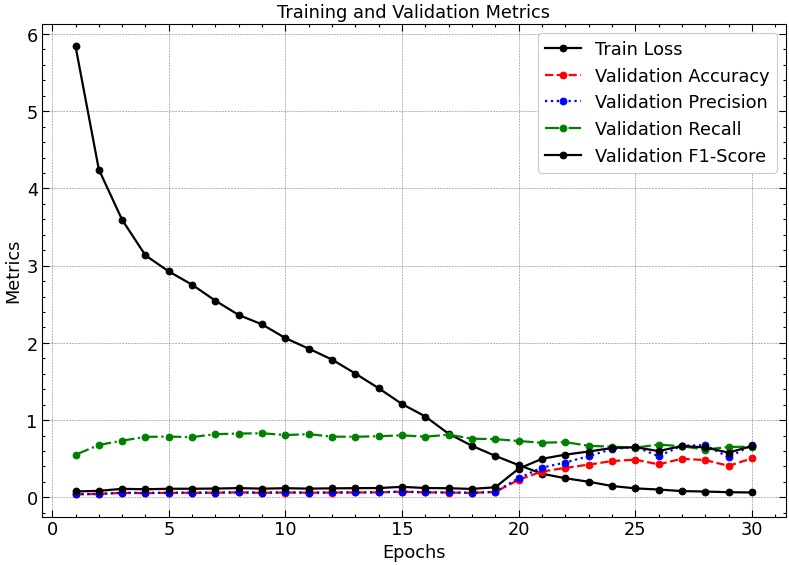

In [ ]:
# Configuración inicial
num_epochs = 30
optimizer = torch.optim.AdamW(model.parameters(), lr=0.0001, weight_decay=0.0005)
scheduler = torch.optim.lr_scheduler.OneCycleLR(
    optimizer,
    max_lr=0.01,
    steps_per_epoch=len(train_loader),
    epochs=num_epochs,
)
scaler = GradScaler()  # Para AMP (Automatic Mixed Precision)

# Para almacenar métricas
train_losses = []
val_accuracies = []
val_precisions = []
val_recalls = []
val_f1_metrics = []

model.train()


# Entrenamiento y Validación
for epoch in range(num_epochs):
    model.train()
    running_loss = 0.0

    # Entrenamiento
    for images, targets in train_loader:
        images = [img.to(device) for img in images]
        targets = [{k: v.to(device) for k, v in t.items()} for t in targets]

        optimizer.zero_grad()

        # Mixed Precision
        with autocast():
            loss_dict = model(images, targets)
            losses = sum(loss for loss in loss_dict.values())

        # Backpropagation y optimización
        scaler.scale(losses).backward()
        scaler.unscale_(optimizer)
        torch.nn.utils.clip_grad_norm_(model.parameters(), max_norm=5.0)
        scaler.step(optimizer)
        scaler.update()

        running_loss += losses.item()

    train_losses.append(running_loss / len(train_loader))

    # Validación
    model.eval()
    precision, recall, accuracy = 0, 0, 0
    with torch.no_grad():
        for images, targets in val_loader:
            images = [img.to(DEVICE) for img in images]
            targets = [{k: v.to(DEVICE) for k, v in t.items()} for t in targets]

            predictions = model(images)
            p, r, acc = calculate_metrics_with_iou(predictions, targets)
            precision += p
            recall += r
            accuracy += acc

    precision /= len(val_loader)
    recall /= len(val_loader)
    accuracy /= len(val_loader)
    f1_metric = 2 * (precision * recall) / (precision + recall + 1e-6)

    # Logging
    val_precisions.append(precision)
    val_recalls.append(recall)
    val_accuracies.append(accuracy)
    val_f1_metrics.append(f1_metric)

    print(f"Epoch [{epoch + 1}/{num_epochs}] - "
          f"Train Loss: {train_losses[-1]:.4f}, "
          f"Precision: {precision:.4f}, "
          f"Recall: {recall:.4f}, "
          f"Accuracy: {accuracy:.4f}, "
          f"F1-Score: {f1_metric:.4f}")

# Gráficas del proceso de entrenamiento y validación
epochs = range(1, num_epochs + 1)

plt.figure(figsize=(12, 8))
plt.plot(epochs, train_losses, label='Train Loss', marker='o')
plt.plot(epochs, val_accuracies, label='Validation Accuracy', marker='o')
plt.plot(epochs, val_precisions, label='Validation Precision', marker='o')
plt.plot(epochs, val_recalls, label='Validation Recall', marker='o')
plt.plot(epochs, val_f1_metrics, label='Validation F1-Score', marker='o')
plt.xlabel('Epochs')
plt.ylabel('Metrics')
plt.title('Training and Validation Metrics')
plt.legend()
plt.grid(True)
plt.show()

In [ ]:
model_save_path = PATH_PROYECTO + "modelo_ssd_sin_data_aug.pth"

torch.save(model.state_dict(), model_save_path)
print(f"Modelo guardado en {model_save_path}")

Modelo guardado en /content/drive/My Drive/Colab Notebooks/VC_PROYECTO/modelo_ssd_sin_data_aug.pth


#### Metricas Conjunto Sin Data Augmentation

In [ ]:
train_data = PATH_XMLS_SIN_DA + 'train/'
valid_data = PATH_XMLS_SIN_DA + 'valid/'
test_data = PATH_XMLS_SIN_DA + 'test/'

data_transforms = transforms.Compose([
    transforms.Resize((600, 600)),
    transforms.ToTensor(),
])

train_dataset = CustomSSDDataset(train_data, data_transforms)
val_dataset = CustomSSDDataset(valid_data, data_transforms)
test_dataset = CustomSSDDataset(test_data, data_transforms)


train_loader = DataLoader(train_dataset, batch_size=8, shuffle=False, collate_fn=collate_fn)
val_loader = DataLoader(val_dataset, batch_size=8, shuffle=False, collate_fn=collate_fn)
test_loader = DataLoader(test_dataset, batch_size=8, shuffle=False, collate_fn=collate_fn)

In [ ]:
evaluate_ssd(model, train_loader, train_data, DEVICE, confidence=0.5);

loading annotations into memory...
Done (t=0.03s)
creating index...
index created!
Loading and preparing results...
DONE (t=0.01s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
DONE (t=4.10s).
Accumulating evaluation results...
DONE (t=0.11s).
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.635
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.949
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.768
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.596
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.842
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.817
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.051
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.376
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets

Por otro lado el conjunto original sin ninguna DA vemos que con los datos de entrenamiento sigue el mismo patrón que con los datos con las técnicas clásicas presentando muy buenos resultados en todas las métricas.

In [ ]:
evaluate_ssd(model, val_loader, valid_data, DEVICE, confidence=0.5);

loading annotations into memory...
Done (t=0.01s)
creating index...
index created!
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
DONE (t=0.44s).
Accumulating evaluation results...
DONE (t=0.02s).
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.200
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.403
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.175
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.134
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.554
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.033
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.194
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDet

En este caso una vez más observamos como ha habido un decremento sustancial en el rendimiento del modelo para el conjunto de validación en torno a un 40% de empeoramiento al igual que lo ocurrido en el conjunto con las data augmentation clásicas.

In [ ]:
evaluate_ssd(model, test_loader, test_data, DEVICE, confidence=0.5);

loading annotations into memory...
Done (t=0.00s)
creating index...
index created!
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
DONE (t=0.21s).
Accumulating evaluation results...
DONE (t=0.02s).
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.202
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.400
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.187
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.115
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.522
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.101
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.034
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.190
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets

Por último el conjunto de datos de test ofrece unos resultados prácticamente equivalentes a los que tienen el conjunto de validación por lo que se puede concluir que el resultado para este conjunto de datos es ligeramente inferior a los resultados con las técnicas clásicas.

### Entrenamiento Conjunto Inpainting

In [ ]:
train_data = PATH_XMLS_ARTIFICIAL + 'train/'
valid_data = PATH_XMLS_ARTIFICIAL + 'valid/'
test_data = PATH_XMLS_ARTIFICIAL + 'test/'

data_transforms = transforms.Compose([
    transforms.Resize((600, 600)),
    transforms.ToTensor(),
])

train_dataset = CustomSSDDataset(train_data, data_transforms)
val_dataset = CustomSSDDataset(valid_data, data_transforms)
test_dataset = CustomSSDDataset(test_data, data_transforms)


train_loader = DataLoader(train_dataset, batch_size=8, shuffle=True, collate_fn=collate_fn)
val_loader = DataLoader(val_dataset, batch_size=8, shuffle=True, collate_fn=collate_fn)
test_loader = DataLoader(test_dataset, batch_size=8, shuffle=True, collate_fn=collate_fn)

In [ ]:
model = crear_modelo_ssd(DEVICE)

<ipython-input-34-0261ead8662d>:10: FutureWarning: `torch.cuda.amp.GradScaler(args...)` is deprecated. Please use `torch.amp.GradScaler('cuda', args...)` instead.
  scaler = GradScaler()  # Para AMP (Automatic Mixed Precision)
<ipython-input-34-0261ead8662d>:35: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with autocast():


Epoch [1/25] - Train Loss: 4.7880, Precision: 0.0522, Recall: 0.7060, Accuracy: 0.0508, F1-Score: 0.0972
Epoch [2/25] - Train Loss: 3.2242, Precision: 0.0567, Recall: 0.7374, Accuracy: 0.0555, F1-Score: 0.1053
Epoch [3/25] - Train Loss: 2.8627, Precision: 0.0654, Recall: 0.8104, Accuracy: 0.0641, F1-Score: 0.1211
Epoch [4/25] - Train Loss: 2.5907, Precision: 0.0657, Recall: 0.8214, Accuracy: 0.0644, F1-Score: 0.1216
Epoch [5/25] - Train Loss: 2.4042, Precision: 0.0627, Recall: 0.8381, Accuracy: 0.0616, F1-Score: 0.1167
Epoch [6/25] - Train Loss: 2.1852, Precision: 0.0625, Recall: 0.8261, Accuracy: 0.0615, F1-Score: 0.1161
Epoch [7/25] - Train Loss: 1.9276, Precision: 0.0648, Recall: 0.8557, Accuracy: 0.0638, F1-Score: 0.1205
Epoch [8/25] - Train Loss: 1.7130, Precision: 0.0674, Recall: 0.8361, Accuracy: 0.0663, F1-Score: 0.1247
Epoch [9/25] - Train Loss: 1.4800, Precision: 0.0612, Recall: 0.7980, Accuracy: 0.0598, F1-Score: 0.1137
Epoch [10/25] - Train Loss: 1.1909, Precision: 0.0618, 

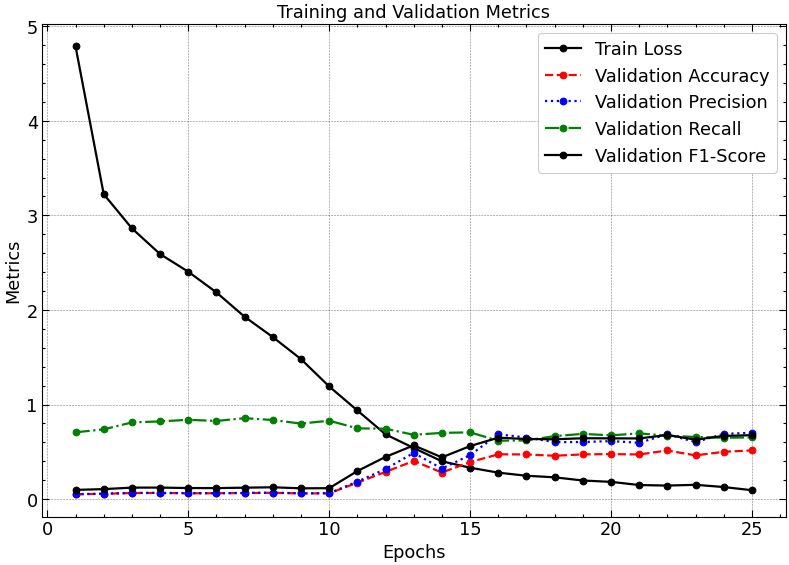

In [ ]:
# Configuración inicial
num_epochs = 25
optimizer = torch.optim.AdamW(model.parameters(), lr=0.0001, weight_decay=0.0005)
scheduler = torch.optim.lr_scheduler.OneCycleLR(
    optimizer,
    max_lr=0.01,
    steps_per_epoch=len(train_loader),
    epochs=num_epochs,
)
scaler = GradScaler()  # Para AMP (Automatic Mixed Precision)

# Para almacenar métricas
train_losses = []
val_accuracies = []
val_precisions = []
val_recalls = []
val_f1_metrics = []

model.train()


# Entrenamiento y Validación
for epoch in range(num_epochs):
    model.train()
    running_loss = 0.0

    # Entrenamiento
    for images, targets in train_loader:
        images = [img.to(device) for img in images]
        targets = [{k: v.to(device) for k, v in t.items()} for t in targets]

        optimizer.zero_grad()

        # Mixed Precision
        with autocast():
            loss_dict = model(images, targets)
            losses = sum(loss for loss in loss_dict.values())

        # Backpropagation y optimización
        scaler.scale(losses).backward()
        scaler.unscale_(optimizer)
        torch.nn.utils.clip_grad_norm_(model.parameters(), max_norm=5.0)
        scaler.step(optimizer)
        scaler.update()

        running_loss += losses.item()

    train_losses.append(running_loss / len(train_loader))

    # Validación
    model.eval()
    precision, recall, accuracy = 0, 0, 0
    with torch.no_grad():
        for images, targets in val_loader:
            images = [img.to(DEVICE) for img in images]
            targets = [{k: v.to(DEVICE) for k, v in t.items()} for t in targets]

            predictions = model(images)
            p, r, acc = calculate_metrics_with_iou(predictions, targets)
            precision += p
            recall += r
            accuracy += acc

    precision /= len(val_loader)
    recall /= len(val_loader)
    accuracy /= len(val_loader)
    f1_metric = 2 * (precision * recall) / (precision + recall + 1e-6)

    # Logging
    val_precisions.append(precision)
    val_recalls.append(recall)
    val_accuracies.append(accuracy)
    val_f1_metrics.append(f1_metric)

    print(f"Epoch [{epoch + 1}/{num_epochs}] - "
          f"Train Loss: {train_losses[-1]:.4f}, "
          f"Precision: {precision:.4f}, "
          f"Recall: {recall:.4f}, "
          f"Accuracy: {accuracy:.4f}, "
          f"F1-Score: {f1_metric:.4f}")

# Gráficas del proceso de entrenamiento y validación
epochs = range(1, num_epochs + 1)

plt.figure(figsize=(12, 8))
plt.plot(epochs, train_losses, label='Train Loss', marker='o')
plt.plot(epochs, val_accuracies, label='Validation Accuracy', marker='o')
plt.plot(epochs, val_precisions, label='Validation Precision', marker='o')
plt.plot(epochs, val_recalls, label='Validation Recall', marker='o')
plt.plot(epochs, val_f1_metrics, label='Validation F1-Score', marker='o')
plt.xlabel('Epochs')
plt.ylabel('Metrics')
plt.title('Training and Validation Metrics')
plt.legend()
plt.grid(True)
plt.show()

In [ ]:
model_save_path = PATH_PROYECTO + "modelo_ssd_artificial.pth"

torch.save(model.state_dict(), model_save_path)
print(f"Modelo guardado en {model_save_path}")

Modelo guardado en /content/drive/My Drive/Colab Notebooks/VC_PROYECTO/modelo_ssd_artificial.pth


#### Metricas Conjunto Inpainting

In [ ]:
train_data = PATH_XMLS_ARTIFICIAL + 'train/'
valid_data = PATH_XMLS_ARTIFICIAL + 'valid/'
test_data = PATH_XMLS_ARTIFICIAL + 'test/'

data_transforms = transforms.Compose([
    transforms.Resize((600, 600)),
    transforms.ToTensor(),
])

train_dataset = CustomSSDDataset(train_data, data_transforms)
val_dataset = CustomSSDDataset(valid_data, data_transforms)
test_dataset = CustomSSDDataset(test_data, data_transforms)


train_loader = DataLoader(train_dataset, batch_size=8, shuffle=False, collate_fn=collate_fn)
val_loader = DataLoader(val_dataset, batch_size=8, shuffle=False, collate_fn=collate_fn)
test_loader = DataLoader(test_dataset, batch_size=8, shuffle=False, collate_fn=collate_fn)

In [ ]:
evaluate_ssd(model, val_loader, valid_data, DEVICE, confidence=0.5);

loading annotations into memory...
Done (t=0.32s)
creating index...
index created!
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
DONE (t=0.40s).
Accumulating evaluation results...
DONE (t=0.03s).
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.207
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.393
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.181
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.135
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.584
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.035
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.195
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDet

Podemos ver como los resultados son ligeramente inferiores a los obtenidos con las técnicas clásicas esto nos puede hacer intuir que realmente la calidad del conjunto de datos no ha mejorado sino que se ha mantenido o inclusive ha empeorado un poco pero la diferencia tan baja de esta hace que no podamos tener una opinión 100% y certera de lo que puede ocurrir.

In [ ]:
evaluate_ssd(model, test_loader, test_data, DEVICE, confidence=0.5);

loading annotations into memory...
Done (t=0.40s)
creating index...
index created!
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
DONE (t=0.12s).
Accumulating evaluation results...
DONE (t=0.01s).
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.215
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.412
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.214
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.127
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.553
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.038
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.199
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets

Por último con el conjunto de texto observamos una vez más el mismo patrón teniendo un empeoramiento leve en los resultados.

Una vez más observamos un patrón extraño teniendo grandes dificultades para identificar objetos grandes cosas que no podemos encontrar el sentido ya que por regla general estos modelos se comportan de mejor forma cuando los objetos son grandes ya que son más sencillos de detectar.

## Resultados y Conclusiones

La calidad y cantidad de los datos es un punto **extremadamente** importante para el rendimiento y funcionamiento correcto de los modelos en el ámbito del machine learning.

En este proyecto hemos intentado abordar la creación sintética de datos intentando aumentar la cantidad y calidad a la vez, haciendo uso tanto de  técnicas clásicas de data augmentation como técnicas más modernas basadas en modelos de difusión.


Como hemos podido ver a lo largo del notebook, el problema que tenemos enfrentado **no** es sencillo puesto que el tamaño de los objetos junto al color de estos, su contraste con la pista y la baja resolución de las imágenes dificulta en **enorme** medida su detección por lo que esperábamos que con esta técnica llegaran a aumentar de forma notable. Pero como hemos podido ver no ha sido el caso, mejorando solo un levemente en Faster R-CNN y YOLO y empeorando ligeramente con SSD.

Estos resultados creemos que pueden ser así debido a que actualmente y con la tecnología disponible no se puede generar estas imágenes de la calidad y el realismo suficiente para poder llegar a emular de alguna manera las imágenes reales y en combinación con la dificultad alta de este problema hace que o mejore muy poco o llegue a empeorar o bien que el entrenamiento de un modelo con datos artificiales puede no ser la mejor opción como discutieron los autores en el paper:

Shumailov, I., Shumaylov, Z., Zhao, Y., Papernot, N., Anderson, R., & Gal, Y. (2024). AI models collapse when trained on recursively generated data. Nature, 631(8022), 755-759.



Pese a que no hemos obtenido grandes resultados este trabajo nos ha sido de gran utilidad ya que hemos podido aprender cómo funciona estos modelos de difusión y diferentes técnicas para poder abordar este problema o similares así como el uso y funcionamiento de modelos de detección de objetos los cuales por falta de tiempo no han podido ser vistos en la asignatura.